<a href="https://colab.research.google.com/github/miko-sri25/Fake-News-Detection---SVM/blob/main/SVM(MP)(D2).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd
import os

In [ ]:
from google.colab import files
files.upload()

Saving fake_or_real_news.csv to fake_or_real_news.csv


{'fake_or_real_news.csv': b',title,text,label\n8476,You Can Smell Hillary\xe2\x80\x99s Fear,"Daniel Greenfield, a Shillman Journalism Fellow at the Freedom Center, is a New York writer focusing on radical Islam. \nIn the final stretch of the election, Hillary Rodham Clinton has gone to war with the FBI. \nThe word \xe2\x80\x9cunprecedented\xe2\x80\x9d has been thrown around so often this election that it ought to be retired. But it\xe2\x80\x99s still unprecedented for the nominee of a major political party to go war with the FBI. \nBut that\xe2\x80\x99s exactly what Hillary and her people have done. Coma patients just waking up now and watching an hour of CNN from their hospital beds would assume that FBI Director James Comey is Hillary\xe2\x80\x99s opponent in this election. \nThe FBI is under attack by everyone from Obama to CNN. Hillary\xe2\x80\x99s people have circulated a letter attacking Comey. There are currently more media hit pieces lambasting him than targeting Trump. It woul

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
fake_news=pd.read_csv("fake_or_real_news.csv")

In [ ]:
fake_news.head()

,Unnamed: 0,title,text,label
0,8476,You Can Smell Hillary’s Fear,"Daniel Greenfield, a Shillman Journalism Fello...",FAKE
1,10294,Watch The Exact Moment Paul Ryan Committed Pol...,Google Pinterest Digg Linkedin Reddit Stumbleu...,FAKE
2,3608,Kerry to go to Paris in gesture of sympathy,U.S. Secretary of State John F. Kerry said Mon...,REAL
3,10142,Bernie supporters on Twitter erupt in anger ag...,"— Kaydee King (@KaydeeKing) November 9, 2016 T...",FAKE
4,875,The Battle of New York: Why This Primary Matters,It's primary day in New York and front-runners...,REAL


In [ ]:
fake_news['label'] = pd.factorize(fake_news['label'])[0].astype(np.int64)
fake_news

,Unnamed: 0,title,text,label
0,8476,You Can Smell Hillary’s Fear,"Daniel Greenfield, a Shillman Journalism Fello...",0
1,10294,Watch The Exact Moment Paul Ryan Committed Pol...,Google Pinterest Digg Linkedin Reddit Stumbleu...,0
2,3608,Kerry to go to Paris in gesture of sympathy,U.S. Secretary of State John F. Kerry said Mon...,1
3,10142,Bernie supporters on Twitter erupt in anger ag...,"— Kaydee King (@KaydeeKing) November 9, 2016 T...",0
4,875,The Battle of New York: Why This Primary Matters,It's primary day in New York and front-runners...,1
...,...,...,...,...
6330,4490,State Department says it can't find emails fro...,The State Department told the Republican Natio...,1
6331,8062,The ‘P’ in PBS Should Stand for ‘Plutocratic’ ...,The ‘P’ in PBS Should Stand for ‘Plutocratic’ ...,0
6332,8622,Anti-Trump Protesters Are Tools of the Oligarc...,Anti-Trump Protesters Are Tools of the Oligar...,0
6333,4021,"In Ethiopia, Obama seeks progress on peace, se...","ADDIS ABABA, Ethiopia —President Obama convene...",1


In [ ]:
fake_news["title"]= fake_news["title"].str.lower()
fake_news["text"]= fake_news["text"].str.lower()
fake_news.head()

,Unnamed: 0,title,text,label
0,8476,you can smell hillary’s fear,"daniel greenfield, a shillman journalism fello...",0
1,10294,watch the exact moment paul ryan committed pol...,google pinterest digg linkedin reddit stumbleu...,0
2,3608,kerry to go to paris in gesture of sympathy,u.s. secretary of state john f. kerry said mon...,1
3,10142,bernie supporters on twitter erupt in anger ag...,"— kaydee king (@kaydeeking) november 9, 2016 t...",0
4,875,the battle of new york: why this primary matters,it's primary day in new york and front-runners...,1


In [ ]:
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [ ]:
#stopwords removal
from nltk.corpus import stopwords
stop = stopwords.words('english')
pat = r'\b(?:{})\b'.format('|'.join(stop))
fake_news['title'] = fake_news['title'].str.replace(pat, '')
fake_news['title'] = fake_news['title'].str.replace(r'\s+', ' ')
fake_news['text'] = fake_news['text'].str.replace(pat, '')
fake_news['text'] = fake_news['text'].str.replace(r'\s+', ' ')
fake_news.head()

,Unnamed: 0,title,text,label
0,8476,smell hillary’ fear,"daniel greenfield, shillman journalism fellow ...",0
1,10294,watch exact moment paul ryan committed politic...,google pinterest digg linkedin reddit stumbleu...,0
2,3608,kerry go paris gesture sympathy,u.. secretary state john f. kerry said monday ...,1
3,10142,bernie supporters twitter erupt anger dnc: ' t...,"— kaydee king (@kaydeeking) november 9, 2016 l...",0
4,875,battle new york: primary matters,' primary day new york front-runners hillary c...,1


In [ ]:
#punctuation removal
import re
p = re.compile(r'[^\w\s]+')
fake_news['title'] = [p.sub('', x) for x in fake_news['title'].tolist()]
fake_news['text'] = [p.sub('', x) for x in fake_news['text'].tolist()]
fake_news.head()

,Unnamed: 0,title,text,label
0,8476,smell hillary fear,daniel greenfield shillman journalism fellow f...,0
1,10294,watch exact moment paul ryan committed politic...,google pinterest digg linkedin reddit stumbleu...,0
2,3608,kerry go paris gesture sympathy,u secretary state john f kerry said monday sto...,1
3,10142,bernie supporters twitter erupt anger dnc tri...,kaydee king kaydeeking november 9 2016 lesson...,0
4,875,battle new york primary matters,primary day new york frontrunners hillary cli...,1


In [ ]:
fake_news.shape

(6335, 4)

In [ ]:
X= fake_news.iloc[:,:-1] .values
y= fake_news.iloc[:,-1] .values

In [ ]:
X[0]


array([8476, ' smell hillary fear',
       'daniel greenfield shillman journalism fellow freedom center new york writer focusing radical islam final stretch election hillary rodham clinton gone war fbi word unprecedented thrown around often election ought retired  still unprecedented nominee major political party go war fbi  exactly hillary people done coma patients waking watching hour cnn hospital beds would assume fbi director james comey hillary opponent election fbi attack everyone obama cnn hillary people circulated letter attacking comey currently media hit pieces lambasting targeting trump  surprising clintons allies start running attack ads fbi fbi leadership warned entire leftwing establishment form lynch mob continue going hillary fbi credibility attacked media democrats preemptively head results investigation clinton foundation hillary clinton covert struggle fbi agents obama doj people gone explosively public new york times compared comey j edgar hoover bizarre headline ja

In [ ]:
y[0]

0

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
cv = CountVectorizer(max_features=5000)
News_body = cv.fit_transform(X[:,2]).todense()
News_body

matrix([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 1, ..., 1, 0, 0],
        [1, 1, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]])

In [ ]:
fake_news.drop(fake_news.columns[fake_news.columns.str.contains('unnamed',case = False)],axis = 1, inplace = True)

In [ ]:
fake_news.head()

,title,text,label
0,smell hillary fear,daniel greenfield shillman journalism fellow f...,0
1,watch exact moment paul ryan committed politic...,google pinterest digg linkedin reddit stumbleu...,0
2,kerry go paris gesture sympathy,u secretary state john f kerry said monday sto...,1
3,bernie supporters twitter erupt anger dnc tri...,kaydee king kaydeeking november 9 2016 lesson...,0
4,battle new york primary matters,primary day new york frontrunners hillary cli...,1


In [ ]:
cv_head = CountVectorizer(max_features=5000)
News_head = cv_head.fit_transform(X[:,1]).todense()
News_head

matrix([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]])

In [ ]:
X_mat = np.hstack(( News_head, News_body))

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_mat,y, test_size=0.3, random_state=0)

In [ ]:
from sklearn.svm import SVC # "Support Vector Classifier" 
clf = SVC(kernel='linear')
clf.fit(X_train,y_train)
y_pred=clf.predict(X_test)

In [ ]:
from sklearn.metrics import confusion_matrix
confusion_matrix(y_test, y_pred)

array([[830, 103],
       [101, 867]])

In [ ]:
Accuracy=(830+867)/(867+103+101+830)

In [ ]:
Accuracy

0.8926880589163598

In [ ]:
Speci=(867)/(867+103)

In [ ]:
Speci

0.8938144329896908

In [ ]:
sens=(830)/(830+101)
sens

0.8915145005370569

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

import warnings
warnings.filterwarnings('ignore')
# Import the classifiers
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC # "Support Vector Classifier" 

from sklearn.metrics import roc_curve, roc_auc_score

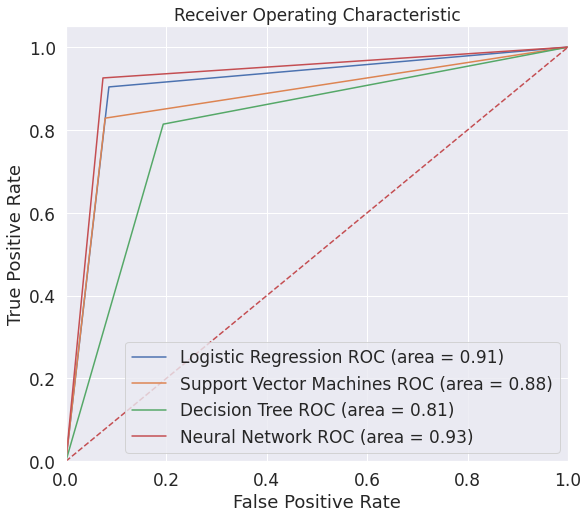

In [ ]:
from sklearn import metrics
import matplotlib.pyplot as plt

plt.figure(figsize=(9,8))

# Add the models to the list that you want to view on the ROC plot
models = [
{
    'label': 'Logistic Regression',
    'model': LogisticRegression(),
},
{
    'label': 'Support Vector Machines',
    'model': SVC(),
},
{
    'label': 'Decision Tree',
    'model': DecisionTreeClassifier(),
},
{
    'label': 'Neural Network',
    'model': MLPClassifier(),
}
]
SMALL_SIZE = 17
MEDIUM_SIZE = 18


plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=MEDIUM_SIZE)  # fontsize of the figure title
# Below for loop iterates through your models list
for m in models:
    model = m['model'] # select the model
    model.fit(X_train, y_train) # train the model
    y_pred=model.predict(X_test) # predict the test data
# Compute False postive rate, and True positive rate
    fpr, tpr, thresholds = metrics.roc_curve(y_test, model.predict(X_test))
# Calculate Area under the curve to display on the plot
    auc = metrics.roc_auc_score(y_test,model.predict(X_test))
# Now, plot the computed values
    plt.plot(fpr, tpr, label='%s ROC (area = %0.2f)' % (m['label'], auc))
# Custom settings for the plot 
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()   # Display
